In [1]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
import torchvision.utils as vutils
import torchvision.datasets as dsets
from torch.utils.data import DataLoader
from torch import optim
from torch import nn

# Library Setups
SEED = 1
torch.manual_seed(SEED)
torch.use_deterministic_algorithms(True)
device = "cuda" if torch.cuda.is_available() else "cpu"

# Superglobals
BATCH_SIZE = 4
IMAGE_SIZE = 64
IMAGE_CHANNELS = 3
ROOT = "data/MonetJPG/" 

# If needed
torch.cuda.empty_cache()

In [2]:
device

'cuda'

In [3]:
dataset = dsets.ImageFolder(
    root = ROOT,
    transform = transforms.Compose([
        transforms.Resize(IMAGE_SIZE),
        transforms.ToTensor(),
        transforms.Normalize((0.5 , 0.5, 0.5), (0.5, 0.5, 0.5)),
    ])
)

dataloader = DataLoader(dataset, BATCH_SIZE, shuffle = True)

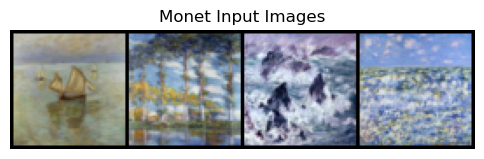

In [4]:
# Plot some training images
batch = next(iter(dataloader))
plt.figure(figsize = (6, 6))
plt.axis("off")
plt.title("Monet Input Images")
plt.imshow(vutils.make_grid(batch[0][:64], normalize = True).permute(1, 2, 0))

### 1. Creating the GAN

In [5]:
class Generator(nn.Module):
    def __init__(self):
        super().__init__()
        self.deconvolution_blocks = nn.Sequential(
            # Block 1
            nn.ConvTranspose2d(in_channels = 64, out_channels = 512, kernel_size = 4, stride = 2, bias = False),
            nn.BatchNorm2d(num_features = 512),
            nn.ReLU(inplace = True),

            # Block 2
            nn.ConvTranspose2d(in_channels = 512, out_channels = 256, kernel_size = 4, stride = 2, padding = 1, bias = False),
            nn.BatchNorm2d(num_features = 256),
            nn.ReLU(inplace = True),

            # Block 3
            nn.ConvTranspose2d(in_channels = 256, out_channels = 128, kernel_size = 4, stride = 2, padding = 1, bias = False),
            nn.BatchNorm2d(num_features = 128),
            nn.ReLU(inplace = True),

            # Block 4
            nn.ConvTranspose2d(in_channels = 128, out_channels = 64, kernel_size = 4, stride = 2, padding = 1, bias = False),
            nn.BatchNorm2d(num_features = 64),
            nn.ReLU(inplace = True),

            # Block 5
            nn.ConvTranspose2d(in_channels = 64, out_channels = 3, kernel_size = 4, stride = 2, padding = 1, bias = False),
            nn.Tanh() # Since our outputs should be -1 to 1 (normalized RGB)
        )
    def forward(self, x):
        return self.deconvolution_blocks(x)

In [6]:
generator = Generator().to(device)
generator

Generator(
  (deconvolution_blocks): Sequential(
    (0): ConvTranspose2d(64, 512, kernel_size=(4, 4), stride=(2, 2), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13)

In [7]:
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.convolution_blocks = nn.Sequential(
            # Block 1
            nn.Conv2d(in_channels = 3, out_channels = 128, kernel_size = 2, stride = 2, bias = False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.4, inplace = True),

            # Block 2
            nn.Conv2d(in_channels = 128, out_channels = 256, kernel_size = 4, stride = 2, padding = 1, bias = False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.4, inplace = True),

            # Block 3
            nn.Conv2d(in_channels = 256, out_channels = 512, kernel_size = 4, stride = 2, padding = 1, bias = False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.4, inplace = True),

            # Block 4
            nn.Conv2d(in_channels = 512, out_channels = 1024, kernel_size = 4, stride = 2, padding = 1, bias = False),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.4),

            # Block 5
            nn.Conv2d(in_channels = 1024, out_channels = 1, kernel_size = 4, stride = 4, padding = 1, bias = False),
            nn.Sigmoid(),
        )
    def forward(self, x):
        return self.convolution_blocks(x)

In [8]:
discriminator = Discriminator().to(device)

In [9]:
loss_fn = nn.BCELoss()
input = torch.randn(64, 64, 1, 1, device = device)

optimizer_generator = optim.Adam(generator.parameters(), lr = 1e-3)
optimizer_discriminator = optim.Adam(discriminator.parameters(), lr = 1e-3)

In [10]:
# Training
# It takes a long time to learn. Like a really long time, until I resorted to PyTorch
# Loss is using Wasserstein Loss to prevent mode collapse
epochs = 300
img_generated = []
generator_history = []
discriminator_history = []
epoch_count = []
for i in range (epochs):
    for j, batch in enumerate(dataloader, 0):
        # Train Discriminator with Real Data
        discriminator.zero_grad()
        real = batch[0].to(device)
        real_label = torch.ones(BATCH_SIZE, dtype = torch.float, device = device)
        output = discriminator(real)
        discriminator_loss_real = loss_fn(output.squeeze(), real_label)
        discriminator_loss_real.backward()
        average_real_output = output.mean().item()

        # Train Discriminator with Fake Data fed to Generator
        noise = torch.randn(BATCH_SIZE, 64, 1, 1, device = device)
        fake = generator(noise)
        fake_label = torch.zeros_like(real_label, dtype = torch.float, device = device)
        output = discriminator(fake.detach())
        discriminator_loss_fake = loss_fn(output.squeeze(), fake_label)
        discriminator_loss_fake.backward()
        average_fake_output = output.mean().item()

        discriminator_error = discriminator_loss_real + discriminator_loss_fake
        optimizer_discriminator.step()

        # Train Generator 
        generator.zero_grad()
        output = discriminator(fake) # We already updated the Discriminator
        generator_loss = loss_fn(output.squeeze(), real_label)
        generator_loss.backward()

        optimizer_generator.step()

        print(f"[{i}/{epochs}] [{j} / {len(dataloader)}] Generator Loss: {generator_loss:.2f} AVG. Real: {average_real_output:.2f} AVG. Fake: {average_fake_output:.2f} Discriminator Loss: {discriminator_error:.2f}", end = '\r')
        
        if (j == BATCH_SIZE and i % 10 == 0):
            generator_history.append(generator_loss.detach().cpu())
            discriminator_history.append(discriminator_error.detach().cpu())
            epoch_count.append(i)
            with torch.inference_mode():
                fake_img = generator(input).detach().cpu()
            img_generated.append(vutils.make_grid(fake_img, normalize = True))


Animation size has reached 21134179 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


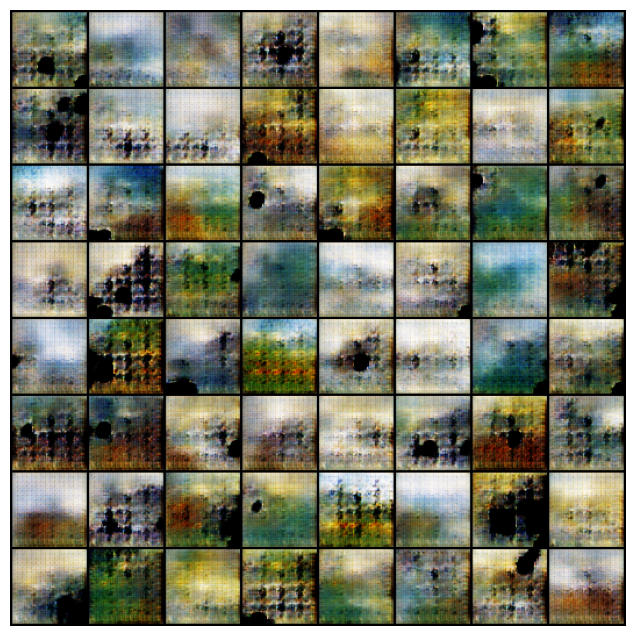

In [11]:
import matplotlib.animation as animation
from IPython.display import HTML
fig = plt.figure(figsize=( 8, 8 ))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_generated]
ani = animation.ArtistAnimation(fig, ims, interval = 5000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

Honestly still quite terrible.
I can see some aspects of Monet there though, particularly the colors.

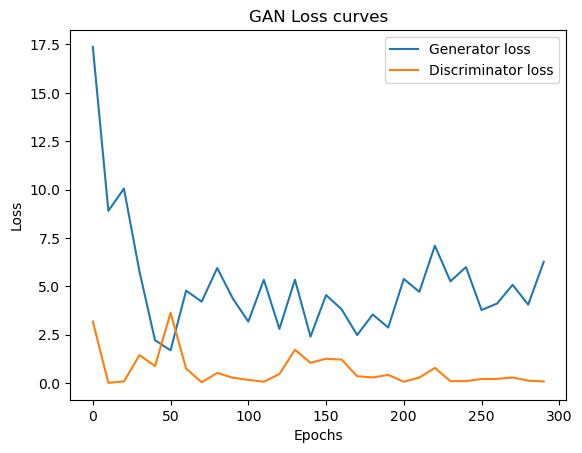

In [12]:
plt.plot(epoch_count, generator_history, label = "Generator loss")
plt.plot(epoch_count, discriminator_history, label = "Discriminator loss")
plt.title("GAN Loss curves")
plt.ylabel("Loss")
plt.xlabel("Epochs")
plt.legend()

The model is obviously not converging well. Discriminator loss is always lower than generator loss. If you see the 
average predictions made during the training, you can see that the discriminator still had on average 0.78 on the real class, and a terribly low 0.02 on the fake class. Ideally, this both should be 0.5 as the discriminator is incapable to differentiate the real with the fake.

In other words, the Generator is stuck. It is not able to learn as much as the discriminator does, thereby this GAN model has not converged properly.

I do not quite understand PyTorch too much, but it certainly helps on understanding the process of GANs. Perhaps the model will be better if the CNN was modelled differently, I do not have the knowledge to know what CNN architectures are good. 

Dataset is available here: https://www.kaggle.com/competitions/gan-getting-started